In [1]:
!pip install kaggle
!pip install torchsummary
!pip install imageio

In [2]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as tt
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.utils import save_image, make_grid
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from torch.nn.utils import spectral_norm
from torch.utils.tensorboard import SummaryWriter
import torchvision.utils as vutils
import sys
import subprocess
from torchsummary import summary
import imageio
from IPython.display import Video
from IPython.display import Image

In [3]:
os.environ['KAGGLE_CONFIG_DIR'] = "/content"
!chmod 600 /content/kaggle.json

chmod: cannot access '/content/kaggle.json': No such file or directory


In [4]:
dataset_path = '/content/dataset'
if not os.path.exists(dataset_path):
    # If the dataset folder doesn't exist, download and unzip the dataset
    !kaggle datasets download -d ikarus777/best-artworks-of-all-time -p {dataset_path} --unzip
else:
    print("Dataset already downloaded.")

Dataset already downloaded.


In [5]:
data_dir = '/content/dataset/resized'
image_save_path = '/content/generated_images/'
os.makedirs(image_save_path, exist_ok=True)

In [6]:
def get_mean_std(loader):
    # Vectors to hold image mean and std
    mean = 0.
    std = 0.
    total_images_count = 0
    for images, _ in tqdm(loader, desc="Calculating mean and std"):
        images = images.view(images.size(0), images.size(1), -1)
        mean += images.mean(2).sum(0)
        std += images.std(2).sum(0)
        total_images_count += images.size(0)

    # Final mean and std
    mean /= total_images_count
    std /= total_images_count
    return mean, std

In [7]:
pre_transforms = tt.Compose([
    tt.Resize((128, 128)),
    tt.ToTensor(),
])
pre_dataset = ImageFolder(data_dir, transform=pre_transforms)
pre_loader = DataLoader(pre_dataset, batch_size=64, shuffle=False, num_workers=2)

# Calculate mean and std
dataset_mean, dataset_std = get_mean_std(pre_loader)

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Calculating mean and std:   0%|          | 0/136 [00:00<?, ?it/s]

In [8]:
transformations = tt.Compose([

    tt.Resize((128, 128)),
    tt.RandomHorizontalFlip(),
    tt.RandomRotation(5),
    tt.ToTensor(),
    tt.Normalize(dataset_mean.tolist(), dataset_std.tolist())
])

dataset = ImageFolder(data_dir, transform=transformations)
train_dl = DataLoader(dataset, batch_size=64, shuffle=True, num_workers=2, pin_memory=True)

In [9]:
print(f"Total number of images in dataset: {len(dataset)}")

Total number of images in dataset: 8683


In [10]:
num_batches = len(train_dl)
print(f"Number of batches per epoch (batch size = 64): {num_batches}")

Number of batches per epoch (batch size = 64): 136


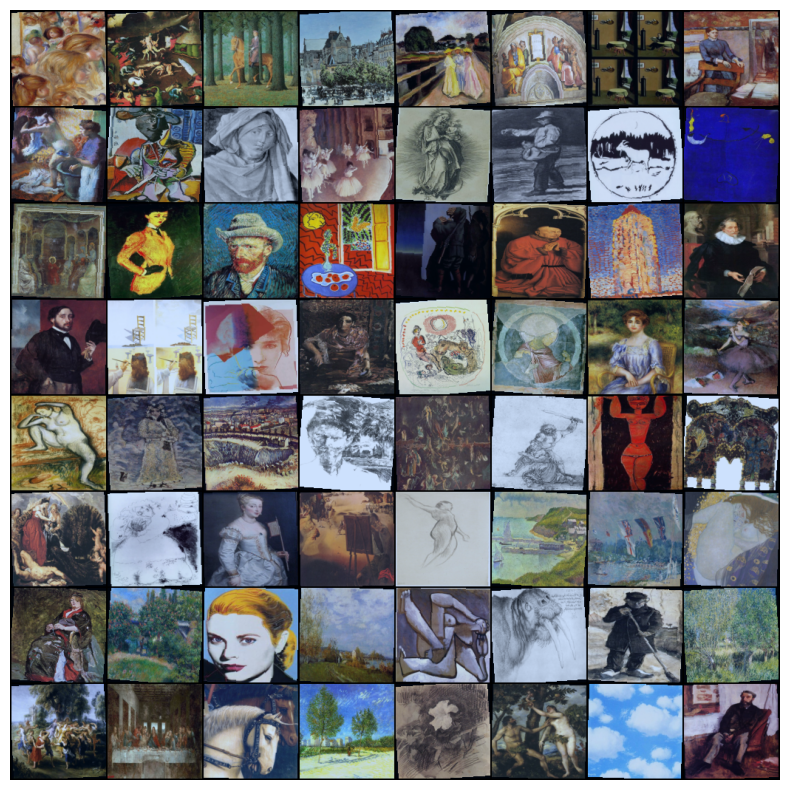

In [11]:
dataiter = iter(train_dl)
images, labels = next(dataiter)

# Create a grid of images
img_grid = vutils.make_grid(images, nrow=8, normalize=True)

# Display these images
plt.figure(figsize=(10, 10))
plt.imshow(img_grid.permute(1, 2, 0))
plt.axis('off')
plt.show()

In [12]:
class Generator(nn.Module):
    def __init__(self, latent_size=128):
        super(Generator, self).__init__()

        # Initial layers focus on broader features
        self.initial_layers = nn.Sequential(
            nn.ConvTranspose2d(latent_size, 1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.ReLU(True),
            nn.BatchNorm2d(1024),

            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(True),
            nn.BatchNorm2d(512),
        )

        # Detail layers focus on finer details
        self.detail_layers = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(True),
            nn.BatchNorm2d(256),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(True),
            nn.BatchNorm2d(128),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.ReLU(True),
            nn.BatchNorm2d(64),

            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh(),
        )

    def forward(self, x):
        x = self.initial_layers(x)
        x = self.detail_layers(x)
        return x

In [13]:
class Discriminator(nn.Module):
    def __init__(self, dropout_rate=0.3):
        super(Discriminator, self).__init__()

        self.disc = nn.Sequential(
            spectral_norm(nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),

            spectral_norm(nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),

            spectral_norm(nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),

            spectral_norm(nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),

            spectral_norm(nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False)),
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Flatten(),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.disc(x)


In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = Generator().to(device)
discriminator = Discriminator().to(device)

opt_d = torch.optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))

In [15]:
def adjust_learning_rates(optimizer_initial, optimizer_detail, feedback_signal):

    lr_adjustment_factor = 0.95

    # discriminator is too good
    if feedback_signal > 0.8:
        for param_group in optimizer_initial.param_groups:
            param_group['lr'] *= lr_adjustment_factor
        for param_group in optimizer_detail.param_groups:
            param_group['lr'] *= lr_adjustment_factor

    # discriminator is too poor
    elif feedback_signal < 0.3:
        for param_group in optimizer_initial.param_groups:
            param_group['lr'] /= lr_adjustment_factor
        for param_group in optimizer_detail.param_groups:
            param_group['lr'] /= lr_adjustment_factor


In [16]:
opt_initial = torch.optim.Adam(generator.initial_layers.parameters(), lr=0.0002, betas=(0.5, 0.999))
opt_detail = torch.optim.Adam(generator.detail_layers.parameters(), lr=0.00005, betas=(0.5, 0.999))

In [17]:
def train_discriminator(real_images):

    # Adding Gaussian noise
    noise = torch.randn_like(real_images) * 0.05
    real_images = real_images + noise

    opt_d.zero_grad()
    real_preds = discriminator(real_images)
    real_targets = torch.full_like(real_preds, 0.9)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()

    latent = torch.randn(real_images.size(0), 128, 1, 1, device=device)
    fake_images = generator(latent)
    fake_preds = discriminator(fake_images.detach())
    fake_targets = torch.full_like(fake_preds, 0.1)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score


In [18]:
def train_generator():

    # Zero the gradients for both optimizers
    opt_initial.zero_grad()
    opt_detail.zero_grad()

    latent = torch.randn(64, 128, 1, 1, device=device)
    fake_images = generator(latent)
    preds = discriminator(fake_images)
    targets = torch.ones_like(preds)
    loss = F.binary_cross_entropy(preds, targets)

    # Perform backpropagation
    loss.backward()

    # Update both parts of the generator
    opt_initial.step()
    opt_detail.step()

    return loss.item()


In [19]:
def save_models(generator, discriminator, epoch, save_directory="/content/saved_models"):
    os.makedirs(save_directory, exist_ok=True)
    torch.save(generator.state_dict(), os.path.join(save_directory, f"generator_epoch_{epoch}.pth"))
    torch.save(discriminator.state_dict(), os.path.join(save_directory, f"discriminator_epoch_{epoch}.pth"))
    print(f"Saved models to {save_directory} at epoch {epoch}")


In [20]:
num_epochs = 500
save_interval = 100
fixed_latent = torch.randn(64, 128, 1, 1, device=device)
writer = SummaryWriter('runs/gan_experiment')

In [21]:
generator_losses = []
discriminator_losses = []
hyperparams = {
    'g_lr': [], 'd_lr': []
}

In [22]:
for epoch in range(num_epochs):
    epoch_d_loss, epoch_g_loss = 0, 0
    num_batches = len(train_dl)
    discriminator_effectiveness = []

    with tqdm(total=num_batches, desc=f"Epoch {epoch + 1}/{num_epochs}", unit='batch') as pbar:
        for real_images, _ in train_dl:
            real_images = real_images.to(device)
            generator.train()
            discriminator.train()

            # n_critic iterations
            for _ in range(4):
                d_loss, real_score, fake_score = train_discriminator(real_images)
                discriminator_effectiveness.append((real_score + (1 - fake_score)) / 2)
                discriminator_losses.append(d_loss)


            # Generator update
            g_loss = train_generator()
            generator_losses.append(g_loss)

            # Logging
            batch_num = epoch * num_batches + pbar.n
            writer.add_scalar('Loss/Generator', g_loss, batch_num)
            writer.add_scalar('Loss/Discriminator', d_loss, batch_num)

            # Progress update
            pbar.set_postfix_str(f"D Loss: {d_loss:.4f}, G Loss: {g_loss:.4f}")
            pbar.update()

            # Cumulative loss calculation
            epoch_d_loss += d_loss
            epoch_g_loss += g_loss

            # Log current learning rates
            hyperparams['d_lr'].append(opt_d.param_groups[0]['lr'])
            hyperparams['g_lr'].append(opt_initial.param_groups[0]['lr'] + opt_detail.param_groups[0]['lr'])


        # Feedback-based learning rate adjustment
        avg_discriminator_effectiveness = sum(discriminator_effectiveness) / len(discriminator_effectiveness)
        adjust_learning_rates(opt_initial, opt_detail, avg_discriminator_effectiveness)


        # Generate images at the end of each epoch
        with torch.no_grad():
            generated_images = generator(fixed_latent).cpu()
            save_image(generated_images, os.path.join(image_save_path, f'generated_images_epoch_{epoch}.png'), normalize=True, nrow=8)

        # Epoch summary
        print(f"Epoch {epoch + 1}/{num_epochs}: Average D Loss: {epoch_d_loss / num_batches:.4f}, Average G Loss: {epoch_g_loss / num_batches:.4f}")

        # Save models at specified interval
        if (epoch + 1) % save_interval == 0 or epoch == num_epochs - 1:
            save_models(generator, discriminator, epoch)

# Cleanup
writer.close()


Epoch 1/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 1/500: Average D Loss: 0.7533, Average G Loss: 1.9294


Epoch 2/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 2/500: Average D Loss: 0.7841, Average G Loss: 1.7830


Epoch 3/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 3/500: Average D Loss: 0.8142, Average G Loss: 1.6581


Epoch 4/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 4/500: Average D Loss: 0.7937, Average G Loss: 1.6543


Epoch 5/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 5/500: Average D Loss: 0.7825, Average G Loss: 1.6485


Epoch 6/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 6/500: Average D Loss: 0.7953, Average G Loss: 1.5864


Epoch 7/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 7/500: Average D Loss: 0.8143, Average G Loss: 1.4850


Epoch 8/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 8/500: Average D Loss: 0.8592, Average G Loss: 1.2103


Epoch 9/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 9/500: Average D Loss: 0.9089, Average G Loss: 1.0399


Epoch 10/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 10/500: Average D Loss: 0.9422, Average G Loss: 0.9485


Epoch 11/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 11/500: Average D Loss: 0.9498, Average G Loss: 0.9214


Epoch 12/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 12/500: Average D Loss: 0.9640, Average G Loss: 0.8861


Epoch 13/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 13/500: Average D Loss: 0.9702, Average G Loss: 0.8665


Epoch 14/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 14/500: Average D Loss: 0.9799, Average G Loss: 0.8470


Epoch 15/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 15/500: Average D Loss: 0.9840, Average G Loss: 0.8395


Epoch 16/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 16/500: Average D Loss: 0.9910, Average G Loss: 0.8289


Epoch 17/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 17/500: Average D Loss: 0.9984, Average G Loss: 0.8032


Epoch 18/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 18/500: Average D Loss: 1.0089, Average G Loss: 0.7900


Epoch 19/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 19/500: Average D Loss: 1.0109, Average G Loss: 0.7797


Epoch 20/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process


Epoch 20/500: Average D Loss: 1.0179, Average G Loss: 0.7607


Epoch 21/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Epoch 21/500: Average D Loss: 1.0182, Average G Loss: 0.7625


Epoch 22/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Epoch 22/500: Average D Loss: 1.0232, Average G Loss: 0.7476


Epoch 23/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
        if w.is_alive():if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only te

Epoch 23/500: Average D Loss: 1.0262, Average G Loss: 0.7454


Epoch 24/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7b125e54d630>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
self._shutdown_workers()    
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
        if w.is_alive():if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only te

Epoch 24/500: Average D Loss: 1.0249, Average G Loss: 0.7461


Epoch 25/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 25/500: Average D Loss: 1.0273, Average G Loss: 0.7487


Epoch 26/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 26/500: Average D Loss: 1.0370, Average G Loss: 0.7330


Epoch 27/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 27/500: Average D Loss: 1.0256, Average G Loss: 0.7477


Epoch 28/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 28/500: Average D Loss: 1.0294, Average G Loss: 0.7294


Epoch 29/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 29/500: Average D Loss: 1.0366, Average G Loss: 0.7270


Epoch 30/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 30/500: Average D Loss: 1.0333, Average G Loss: 0.7257


Epoch 31/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 31/500: Average D Loss: 1.0553, Average G Loss: 0.7092


Epoch 32/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 32/500: Average D Loss: 1.0357, Average G Loss: 0.7304


Epoch 33/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 33/500: Average D Loss: 1.0387, Average G Loss: 0.7200


Epoch 34/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 34/500: Average D Loss: 1.0371, Average G Loss: 0.7238


Epoch 35/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 35/500: Average D Loss: 1.0304, Average G Loss: 0.7388


Epoch 36/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 36/500: Average D Loss: 1.0453, Average G Loss: 0.7073


Epoch 37/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 37/500: Average D Loss: 1.0483, Average G Loss: 0.7118


Epoch 38/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 38/500: Average D Loss: 1.0444, Average G Loss: 0.7151


Epoch 39/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 39/500: Average D Loss: 1.0640, Average G Loss: 0.7031


Epoch 40/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 40/500: Average D Loss: 1.0455, Average G Loss: 0.7129


Epoch 41/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 41/500: Average D Loss: 1.0526, Average G Loss: 0.7096


Epoch 42/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 42/500: Average D Loss: 1.0563, Average G Loss: 0.7034


Epoch 43/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 43/500: Average D Loss: 1.0492, Average G Loss: 0.7126


Epoch 44/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 44/500: Average D Loss: 1.0516, Average G Loss: 0.7100


Epoch 45/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 45/500: Average D Loss: 1.0520, Average G Loss: 0.7085


Epoch 46/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 46/500: Average D Loss: 1.0491, Average G Loss: 0.7432


Epoch 47/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 47/500: Average D Loss: 1.0363, Average G Loss: 0.7405


Epoch 48/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 48/500: Average D Loss: 1.0403, Average G Loss: 0.7275


Epoch 49/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 49/500: Average D Loss: 1.0522, Average G Loss: 0.7054


Epoch 50/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 50/500: Average D Loss: 1.0474, Average G Loss: 0.7179


Epoch 51/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 51/500: Average D Loss: 1.0452, Average G Loss: 0.7133


Epoch 52/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 52/500: Average D Loss: 1.0476, Average G Loss: 0.7145


Epoch 53/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 53/500: Average D Loss: 1.0503, Average G Loss: 0.7102


Epoch 54/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 54/500: Average D Loss: 1.0549, Average G Loss: 0.7019


Epoch 55/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 55/500: Average D Loss: 1.0505, Average G Loss: 0.7105


Epoch 56/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 56/500: Average D Loss: 1.0546, Average G Loss: 0.7083


Epoch 57/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 57/500: Average D Loss: 1.0563, Average G Loss: 0.7056


Epoch 58/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 58/500: Average D Loss: 1.0467, Average G Loss: 0.7173


Epoch 59/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 59/500: Average D Loss: 1.0545, Average G Loss: 0.7077


Epoch 60/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 60/500: Average D Loss: 1.0634, Average G Loss: 0.6996


Epoch 61/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 61/500: Average D Loss: 1.0573, Average G Loss: 0.7121


Epoch 62/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 62/500: Average D Loss: 1.0545, Average G Loss: 0.7124


Epoch 63/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 63/500: Average D Loss: 1.0545, Average G Loss: 0.7076


Epoch 64/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 64/500: Average D Loss: 1.0661, Average G Loss: 0.6937


Epoch 65/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 65/500: Average D Loss: 1.0590, Average G Loss: 0.7051


Epoch 66/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 66/500: Average D Loss: 1.0580, Average G Loss: 0.7052


Epoch 67/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 67/500: Average D Loss: 1.0583, Average G Loss: 0.7030


Epoch 68/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 68/500: Average D Loss: 1.0607, Average G Loss: 0.7007


Epoch 69/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 69/500: Average D Loss: 1.0621, Average G Loss: 0.7018


Epoch 70/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 70/500: Average D Loss: 1.0609, Average G Loss: 0.7058


Epoch 71/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 71/500: Average D Loss: 1.0537, Average G Loss: 0.7105


Epoch 72/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 72/500: Average D Loss: 1.0662, Average G Loss: 0.7019


Epoch 73/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 73/500: Average D Loss: 1.0658, Average G Loss: 0.7049


Epoch 74/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 74/500: Average D Loss: 1.0589, Average G Loss: 0.7085


Epoch 75/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 75/500: Average D Loss: 1.0627, Average G Loss: 0.7040


Epoch 76/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 76/500: Average D Loss: 1.0654, Average G Loss: 0.6998


Epoch 77/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 77/500: Average D Loss: 1.0616, Average G Loss: 0.7051


Epoch 78/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 78/500: Average D Loss: 1.0809, Average G Loss: 0.6933


Epoch 79/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 79/500: Average D Loss: 1.0598, Average G Loss: 0.7174


Epoch 80/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 80/500: Average D Loss: 1.0631, Average G Loss: 0.7062


Epoch 81/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 81/500: Average D Loss: 1.0733, Average G Loss: 0.7038


Epoch 82/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 82/500: Average D Loss: 1.0724, Average G Loss: 0.7029


Epoch 83/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 83/500: Average D Loss: 1.0702, Average G Loss: 0.7090


Epoch 84/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 84/500: Average D Loss: 1.0777, Average G Loss: 0.7035


Epoch 85/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 85/500: Average D Loss: 1.0691, Average G Loss: 0.7083


Epoch 86/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 86/500: Average D Loss: 1.0841, Average G Loss: 0.6994


Epoch 87/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 87/500: Average D Loss: 1.0730, Average G Loss: 0.7088


Epoch 88/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 88/500: Average D Loss: 1.0669, Average G Loss: 0.7155


Epoch 89/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 89/500: Average D Loss: 1.0769, Average G Loss: 0.7055


Epoch 90/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 90/500: Average D Loss: 1.0741, Average G Loss: 0.7063


Epoch 91/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 91/500: Average D Loss: 1.0821, Average G Loss: 0.7068


Epoch 92/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 92/500: Average D Loss: 1.0784, Average G Loss: 0.7167


Epoch 93/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 93/500: Average D Loss: 1.0806, Average G Loss: 0.7081


Epoch 94/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 94/500: Average D Loss: 1.0802, Average G Loss: 0.7126


Epoch 95/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 95/500: Average D Loss: 1.0728, Average G Loss: 0.7152


Epoch 96/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 96/500: Average D Loss: 1.0673, Average G Loss: 0.7184


Epoch 97/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 97/500: Average D Loss: 1.0837, Average G Loss: 0.7069


Epoch 98/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 98/500: Average D Loss: 1.0778, Average G Loss: 0.7094


Epoch 99/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 99/500: Average D Loss: 1.0815, Average G Loss: 0.7055


Epoch 100/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 100/500: Average D Loss: 1.0846, Average G Loss: 0.7094
Saved models to /content/saved_models at epoch 99


Epoch 101/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 101/500: Average D Loss: 1.0892, Average G Loss: 0.7100


Epoch 102/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 102/500: Average D Loss: 1.0813, Average G Loss: 0.7048


Epoch 103/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 103/500: Average D Loss: 1.0820, Average G Loss: 0.7050


Epoch 104/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 104/500: Average D Loss: 1.0769, Average G Loss: 0.7167


Epoch 105/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 105/500: Average D Loss: 1.0833, Average G Loss: 0.7112


Epoch 106/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 106/500: Average D Loss: 1.0814, Average G Loss: 0.7134


Epoch 107/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 107/500: Average D Loss: 1.0884, Average G Loss: 0.7115


Epoch 108/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 108/500: Average D Loss: 1.0783, Average G Loss: 0.7144


Epoch 109/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 109/500: Average D Loss: 1.0849, Average G Loss: 0.7055


Epoch 110/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 110/500: Average D Loss: 1.0793, Average G Loss: 0.7148


Epoch 111/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 111/500: Average D Loss: 1.0824, Average G Loss: 0.7144


Epoch 112/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 112/500: Average D Loss: 1.0847, Average G Loss: 0.7087


Epoch 113/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 113/500: Average D Loss: 1.0865, Average G Loss: 0.7093


Epoch 114/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 114/500: Average D Loss: 1.0876, Average G Loss: 0.7054


Epoch 115/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 115/500: Average D Loss: 1.0836, Average G Loss: 0.7083


Epoch 116/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 116/500: Average D Loss: 1.0818, Average G Loss: 0.7172


Epoch 117/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 117/500: Average D Loss: 1.0897, Average G Loss: 0.7068


Epoch 118/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 118/500: Average D Loss: 1.0872, Average G Loss: 0.7131


Epoch 119/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 119/500: Average D Loss: 1.0903, Average G Loss: 0.7083


Epoch 120/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 120/500: Average D Loss: 1.0868, Average G Loss: 0.7226


Epoch 121/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 121/500: Average D Loss: 1.0882, Average G Loss: 0.7057


Epoch 122/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 122/500: Average D Loss: 1.0846, Average G Loss: 0.7178


Epoch 123/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 123/500: Average D Loss: 1.0902, Average G Loss: 0.7068


Epoch 124/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 124/500: Average D Loss: 1.0921, Average G Loss: 0.7020


Epoch 125/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 125/500: Average D Loss: 1.0939, Average G Loss: 0.7087


Epoch 126/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 126/500: Average D Loss: 1.0910, Average G Loss: 0.7067


Epoch 127/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 127/500: Average D Loss: 1.0911, Average G Loss: 0.7139


Epoch 128/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 128/500: Average D Loss: 1.0910, Average G Loss: 0.7087


Epoch 129/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 129/500: Average D Loss: 1.0826, Average G Loss: 0.7220


Epoch 130/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 130/500: Average D Loss: 1.0914, Average G Loss: 0.7082


Epoch 131/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 131/500: Average D Loss: 1.0918, Average G Loss: 0.7096


Epoch 132/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 132/500: Average D Loss: 1.0969, Average G Loss: 0.7049


Epoch 133/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 133/500: Average D Loss: 1.0880, Average G Loss: 0.7149


Epoch 134/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 134/500: Average D Loss: 1.0883, Average G Loss: 0.7084


Epoch 135/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 135/500: Average D Loss: 1.0957, Average G Loss: 0.7042


Epoch 136/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 136/500: Average D Loss: 1.0920, Average G Loss: 0.7119


Epoch 137/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 137/500: Average D Loss: 1.0941, Average G Loss: 0.7076


Epoch 138/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 138/500: Average D Loss: 1.0981, Average G Loss: 0.7020


Epoch 139/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 139/500: Average D Loss: 1.0941, Average G Loss: 0.7165


Epoch 140/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 140/500: Average D Loss: 1.0940, Average G Loss: 0.7134


Epoch 141/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 141/500: Average D Loss: 1.0914, Average G Loss: 0.7135


Epoch 142/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 142/500: Average D Loss: 1.0993, Average G Loss: 0.7026


Epoch 143/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 143/500: Average D Loss: 1.0905, Average G Loss: 0.7166


Epoch 144/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 144/500: Average D Loss: 1.0951, Average G Loss: 0.7112


Epoch 145/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 145/500: Average D Loss: 1.0975, Average G Loss: 0.7129


Epoch 146/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 146/500: Average D Loss: 1.0948, Average G Loss: 0.7150


Epoch 147/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 147/500: Average D Loss: 1.0943, Average G Loss: 0.7074


Epoch 148/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 148/500: Average D Loss: 1.0964, Average G Loss: 0.7117


Epoch 149/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 149/500: Average D Loss: 1.0938, Average G Loss: 0.7101


Epoch 150/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 150/500: Average D Loss: 1.0972, Average G Loss: 0.7147


Epoch 151/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 151/500: Average D Loss: 1.0970, Average G Loss: 0.7111


Epoch 152/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 152/500: Average D Loss: 1.0966, Average G Loss: 0.7146


Epoch 153/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 153/500: Average D Loss: 1.1010, Average G Loss: 0.7057


Epoch 154/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 154/500: Average D Loss: 1.0961, Average G Loss: 0.7102


Epoch 155/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 155/500: Average D Loss: 1.0954, Average G Loss: 0.7126


Epoch 156/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 156/500: Average D Loss: 1.0980, Average G Loss: 0.7096


Epoch 157/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 157/500: Average D Loss: 1.1016, Average G Loss: 0.6991


Epoch 158/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 158/500: Average D Loss: 1.1016, Average G Loss: 0.7052


Epoch 159/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 159/500: Average D Loss: 1.1012, Average G Loss: 0.7100


Epoch 160/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 160/500: Average D Loss: 1.1035, Average G Loss: 0.7014


Epoch 161/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 161/500: Average D Loss: 1.1053, Average G Loss: 0.7049


Epoch 162/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 162/500: Average D Loss: 1.0978, Average G Loss: 0.7126


Epoch 163/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 163/500: Average D Loss: 1.1043, Average G Loss: 0.7060


Epoch 164/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 164/500: Average D Loss: 1.1035, Average G Loss: 0.7039


Epoch 165/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 165/500: Average D Loss: 1.1061, Average G Loss: 0.7071


Epoch 166/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 166/500: Average D Loss: 1.1097, Average G Loss: 0.7001


Epoch 167/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 167/500: Average D Loss: 1.1008, Average G Loss: 0.7099


Epoch 168/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 168/500: Average D Loss: 1.1070, Average G Loss: 0.7078


Epoch 169/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 169/500: Average D Loss: 1.1039, Average G Loss: 0.7138


Epoch 170/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 170/500: Average D Loss: 1.1060, Average G Loss: 0.7104


Epoch 171/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 171/500: Average D Loss: 1.1034, Average G Loss: 0.7064


Epoch 172/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 172/500: Average D Loss: 1.1054, Average G Loss: 0.7056


Epoch 173/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 173/500: Average D Loss: 1.1101, Average G Loss: 0.6990


Epoch 174/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 174/500: Average D Loss: 1.1070, Average G Loss: 0.7040


Epoch 175/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 175/500: Average D Loss: 1.1082, Average G Loss: 0.7005


Epoch 176/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 176/500: Average D Loss: 1.1117, Average G Loss: 0.7003


Epoch 177/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 177/500: Average D Loss: 1.1067, Average G Loss: 0.7000


Epoch 178/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 178/500: Average D Loss: 1.1079, Average G Loss: 0.7085


Epoch 179/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 179/500: Average D Loss: 1.1068, Average G Loss: 0.7093


Epoch 180/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 180/500: Average D Loss: 1.1073, Average G Loss: 0.7058


Epoch 181/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 181/500: Average D Loss: 1.1133, Average G Loss: 0.7000


Epoch 182/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 182/500: Average D Loss: 1.1107, Average G Loss: 0.7020


Epoch 183/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 183/500: Average D Loss: 1.1046, Average G Loss: 0.7194


Epoch 184/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 184/500: Average D Loss: 1.1145, Average G Loss: 0.6956


Epoch 185/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 185/500: Average D Loss: 1.1114, Average G Loss: 0.7069


Epoch 186/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 186/500: Average D Loss: 1.1072, Average G Loss: 0.7114


Epoch 187/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 187/500: Average D Loss: 1.1094, Average G Loss: 0.7064


Epoch 188/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 188/500: Average D Loss: 1.1154, Average G Loss: 0.6939


Epoch 189/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 189/500: Average D Loss: 1.1145, Average G Loss: 0.7025


Epoch 190/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 190/500: Average D Loss: 1.1143, Average G Loss: 0.7018


Epoch 191/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 191/500: Average D Loss: 1.1091, Average G Loss: 0.7131


Epoch 192/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 192/500: Average D Loss: 1.1122, Average G Loss: 0.6981


Epoch 193/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 193/500: Average D Loss: 1.1127, Average G Loss: 0.7063


Epoch 194/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 194/500: Average D Loss: 1.1137, Average G Loss: 0.7015


Epoch 195/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 195/500: Average D Loss: 1.1141, Average G Loss: 0.7026


Epoch 196/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 196/500: Average D Loss: 1.1135, Average G Loss: 0.7068


Epoch 197/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 197/500: Average D Loss: 1.1129, Average G Loss: 0.7074


Epoch 198/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 198/500: Average D Loss: 1.1138, Average G Loss: 0.6998


Epoch 199/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 199/500: Average D Loss: 1.1157, Average G Loss: 0.7023


Epoch 200/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 200/500: Average D Loss: 1.1157, Average G Loss: 0.7028
Saved models to /content/saved_models at epoch 199


Epoch 201/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 201/500: Average D Loss: 1.1178, Average G Loss: 0.6947


Epoch 202/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 202/500: Average D Loss: 1.1137, Average G Loss: 0.6989


Epoch 203/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 203/500: Average D Loss: 1.1136, Average G Loss: 0.7032


Epoch 204/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 204/500: Average D Loss: 1.1124, Average G Loss: 0.7033


Epoch 205/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 205/500: Average D Loss: 1.1114, Average G Loss: 0.7101


Epoch 206/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 206/500: Average D Loss: 1.1126, Average G Loss: 0.7059


Epoch 207/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 207/500: Average D Loss: 1.1110, Average G Loss: 0.7010


Epoch 208/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 208/500: Average D Loss: 1.1159, Average G Loss: 0.6973


Epoch 209/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 209/500: Average D Loss: 1.1139, Average G Loss: 0.7044


Epoch 210/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 210/500: Average D Loss: 1.1193, Average G Loss: 0.7016


Epoch 211/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 211/500: Average D Loss: 1.1133, Average G Loss: 0.7085


Epoch 212/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 212/500: Average D Loss: 1.1190, Average G Loss: 0.7001


Epoch 213/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 213/500: Average D Loss: 1.1221, Average G Loss: 0.6937


Epoch 214/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 214/500: Average D Loss: 1.1234, Average G Loss: 0.6999


Epoch 215/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 215/500: Average D Loss: 1.1175, Average G Loss: 0.6993


Epoch 216/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 216/500: Average D Loss: 1.1216, Average G Loss: 0.6923


Epoch 217/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 217/500: Average D Loss: 1.1171, Average G Loss: 0.6973


Epoch 218/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 218/500: Average D Loss: 1.1199, Average G Loss: 0.7012


Epoch 219/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 219/500: Average D Loss: 1.1207, Average G Loss: 0.6914


Epoch 220/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 220/500: Average D Loss: 1.1227, Average G Loss: 0.7020


Epoch 221/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 221/500: Average D Loss: 1.1186, Average G Loss: 0.6996


Epoch 222/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 222/500: Average D Loss: 1.1183, Average G Loss: 0.7012


Epoch 223/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 223/500: Average D Loss: 1.1210, Average G Loss: 0.6965


Epoch 224/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 224/500: Average D Loss: 1.1213, Average G Loss: 0.6973


Epoch 225/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 225/500: Average D Loss: 1.1196, Average G Loss: 0.7020


Epoch 226/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 226/500: Average D Loss: 1.1182, Average G Loss: 0.6981


Epoch 227/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 227/500: Average D Loss: 1.1169, Average G Loss: 0.6969


Epoch 228/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 228/500: Average D Loss: 1.1179, Average G Loss: 0.6962


Epoch 229/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 229/500: Average D Loss: 1.1188, Average G Loss: 0.6996


Epoch 230/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 230/500: Average D Loss: 1.1231, Average G Loss: 0.6943


Epoch 231/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 231/500: Average D Loss: 1.1214, Average G Loss: 0.6940


Epoch 232/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 232/500: Average D Loss: 1.1205, Average G Loss: 0.6988


Epoch 233/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 233/500: Average D Loss: 1.1219, Average G Loss: 0.6987


Epoch 234/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 234/500: Average D Loss: 1.1208, Average G Loss: 0.6977


Epoch 235/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 235/500: Average D Loss: 1.1195, Average G Loss: 0.7027


Epoch 236/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 236/500: Average D Loss: 1.1340, Average G Loss: 0.6879


Epoch 237/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 237/500: Average D Loss: 1.1256, Average G Loss: 0.6933


Epoch 238/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 238/500: Average D Loss: 1.1231, Average G Loss: 0.7017


Epoch 239/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 239/500: Average D Loss: 1.1193, Average G Loss: 0.7000


Epoch 240/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 240/500: Average D Loss: 1.1273, Average G Loss: 0.6942


Epoch 241/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 241/500: Average D Loss: 1.1257, Average G Loss: 0.6887


Epoch 242/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 242/500: Average D Loss: 1.1236, Average G Loss: 0.6985


Epoch 243/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 243/500: Average D Loss: 1.1283, Average G Loss: 0.6930


Epoch 244/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 244/500: Average D Loss: 1.1323, Average G Loss: 0.6835


Epoch 245/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 245/500: Average D Loss: 1.1245, Average G Loss: 0.6964


Epoch 246/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 246/500: Average D Loss: 1.1227, Average G Loss: 0.6960


Epoch 247/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 247/500: Average D Loss: 1.1272, Average G Loss: 0.6968


Epoch 248/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 248/500: Average D Loss: 1.1237, Average G Loss: 0.6969


Epoch 249/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 249/500: Average D Loss: 1.1258, Average G Loss: 0.6944


Epoch 250/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 250/500: Average D Loss: 1.1317, Average G Loss: 0.6859


Epoch 251/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 251/500: Average D Loss: 1.1270, Average G Loss: 0.6917


Epoch 252/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 252/500: Average D Loss: 1.1214, Average G Loss: 0.7007


Epoch 253/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 253/500: Average D Loss: 1.1270, Average G Loss: 0.6937


Epoch 254/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 254/500: Average D Loss: 1.1283, Average G Loss: 0.6910


Epoch 255/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 255/500: Average D Loss: 1.1307, Average G Loss: 0.6922


Epoch 256/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 256/500: Average D Loss: 1.1263, Average G Loss: 0.6925


Epoch 257/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 257/500: Average D Loss: 1.1328, Average G Loss: 0.6859


Epoch 258/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 258/500: Average D Loss: 1.1266, Average G Loss: 0.7007


Epoch 259/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 259/500: Average D Loss: 1.1305, Average G Loss: 0.6870


Epoch 260/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 260/500: Average D Loss: 1.1330, Average G Loss: 0.6925


Epoch 261/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 261/500: Average D Loss: 1.1298, Average G Loss: 0.6946


Epoch 262/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 262/500: Average D Loss: 1.1298, Average G Loss: 0.6928


Epoch 263/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 263/500: Average D Loss: 1.1301, Average G Loss: 0.6897


Epoch 264/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 264/500: Average D Loss: 1.1280, Average G Loss: 0.6965


Epoch 265/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 265/500: Average D Loss: 1.1300, Average G Loss: 0.6904


Epoch 266/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 266/500: Average D Loss: 1.1307, Average G Loss: 0.6865


Epoch 267/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 267/500: Average D Loss: 1.1323, Average G Loss: 0.6898


Epoch 268/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 268/500: Average D Loss: 1.1320, Average G Loss: 0.6895


Epoch 269/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 269/500: Average D Loss: 1.1346, Average G Loss: 0.6808


Epoch 270/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 270/500: Average D Loss: 1.1287, Average G Loss: 0.7023


Epoch 271/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 271/500: Average D Loss: 1.1252, Average G Loss: 0.6964


Epoch 272/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 272/500: Average D Loss: 1.1317, Average G Loss: 0.6897


Epoch 273/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 273/500: Average D Loss: 1.1288, Average G Loss: 0.6977


Epoch 274/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 274/500: Average D Loss: 1.1306, Average G Loss: 0.6910


Epoch 275/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 275/500: Average D Loss: 1.1283, Average G Loss: 0.6882


Epoch 276/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 276/500: Average D Loss: 1.1322, Average G Loss: 0.6943


Epoch 277/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 277/500: Average D Loss: 1.1313, Average G Loss: 0.6908


Epoch 278/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 278/500: Average D Loss: 1.1247, Average G Loss: 0.6931


Epoch 279/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 279/500: Average D Loss: 1.1298, Average G Loss: 0.6963


Epoch 280/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 280/500: Average D Loss: 1.1327, Average G Loss: 0.6881


Epoch 281/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 281/500: Average D Loss: 1.1360, Average G Loss: 0.6897


Epoch 282/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 282/500: Average D Loss: 1.1333, Average G Loss: 0.6936


Epoch 283/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 283/500: Average D Loss: 1.1310, Average G Loss: 0.6879


Epoch 284/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 284/500: Average D Loss: 1.1333, Average G Loss: 0.6910


Epoch 285/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 285/500: Average D Loss: 1.1363, Average G Loss: 0.6869


Epoch 286/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 286/500: Average D Loss: 1.1339, Average G Loss: 0.6948


Epoch 287/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 287/500: Average D Loss: 1.1323, Average G Loss: 0.6922


Epoch 288/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 288/500: Average D Loss: 1.1335, Average G Loss: 0.6930


Epoch 289/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 289/500: Average D Loss: 1.1330, Average G Loss: 0.6933


Epoch 290/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 290/500: Average D Loss: 1.1334, Average G Loss: 0.6965


Epoch 291/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 291/500: Average D Loss: 1.1344, Average G Loss: 0.6952


Epoch 292/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 292/500: Average D Loss: 1.1372, Average G Loss: 0.6907


Epoch 293/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 293/500: Average D Loss: 1.1386, Average G Loss: 0.6886


Epoch 294/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 294/500: Average D Loss: 1.1347, Average G Loss: 0.6899


Epoch 295/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 295/500: Average D Loss: 1.1388, Average G Loss: 0.6868


Epoch 296/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 296/500: Average D Loss: 1.1369, Average G Loss: 0.6976


Epoch 297/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 297/500: Average D Loss: 1.1405, Average G Loss: 0.6925


Epoch 298/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 298/500: Average D Loss: 1.1404, Average G Loss: 0.6940


Epoch 299/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 299/500: Average D Loss: 1.1387, Average G Loss: 0.6964


Epoch 300/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 300/500: Average D Loss: 1.1380, Average G Loss: 0.6892
Saved models to /content/saved_models at epoch 299


Epoch 301/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 301/500: Average D Loss: 1.1397, Average G Loss: 0.6897


Epoch 302/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 302/500: Average D Loss: 1.1393, Average G Loss: 0.6833


Epoch 303/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 303/500: Average D Loss: 1.1380, Average G Loss: 0.6936


Epoch 304/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 304/500: Average D Loss: 1.1370, Average G Loss: 0.6936


Epoch 305/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 305/500: Average D Loss: 1.1396, Average G Loss: 0.6882


Epoch 306/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 306/500: Average D Loss: 1.1388, Average G Loss: 0.6897


Epoch 307/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 307/500: Average D Loss: 1.1376, Average G Loss: 0.6921


Epoch 308/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 308/500: Average D Loss: 1.1373, Average G Loss: 0.6882


Epoch 309/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 309/500: Average D Loss: 1.1417, Average G Loss: 0.6852


Epoch 310/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 310/500: Average D Loss: 1.1393, Average G Loss: 0.6906


Epoch 311/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 311/500: Average D Loss: 1.1378, Average G Loss: 0.6866


Epoch 312/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 312/500: Average D Loss: 1.1361, Average G Loss: 0.6880


Epoch 313/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 313/500: Average D Loss: 1.1415, Average G Loss: 0.6832


Epoch 314/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 314/500: Average D Loss: 1.1416, Average G Loss: 0.6869


Epoch 315/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 315/500: Average D Loss: 1.1415, Average G Loss: 0.6830


Epoch 316/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 316/500: Average D Loss: 1.1431, Average G Loss: 0.6866


Epoch 317/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 317/500: Average D Loss: 1.1398, Average G Loss: 0.6891


Epoch 318/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 318/500: Average D Loss: 1.1422, Average G Loss: 0.6838


Epoch 319/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 319/500: Average D Loss: 1.1405, Average G Loss: 0.6876


Epoch 320/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 320/500: Average D Loss: 1.1367, Average G Loss: 0.6919


Epoch 321/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 321/500: Average D Loss: 1.1407, Average G Loss: 0.6863


Epoch 322/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 322/500: Average D Loss: 1.1387, Average G Loss: 0.6909


Epoch 323/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 323/500: Average D Loss: 1.1424, Average G Loss: 0.6881


Epoch 324/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 324/500: Average D Loss: 1.1412, Average G Loss: 0.6879


Epoch 325/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 325/500: Average D Loss: 1.1422, Average G Loss: 0.6821


Epoch 326/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 326/500: Average D Loss: 1.1421, Average G Loss: 0.6851


Epoch 327/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 327/500: Average D Loss: 1.1455, Average G Loss: 0.6862


Epoch 328/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 328/500: Average D Loss: 1.1374, Average G Loss: 0.6933


Epoch 329/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 329/500: Average D Loss: 1.1397, Average G Loss: 0.6871


Epoch 330/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 330/500: Average D Loss: 1.1443, Average G Loss: 0.6792


Epoch 331/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 331/500: Average D Loss: 1.1488, Average G Loss: 0.6766


Epoch 332/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 332/500: Average D Loss: 1.1428, Average G Loss: 0.6813


Epoch 333/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 333/500: Average D Loss: 1.1435, Average G Loss: 0.6836


Epoch 334/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 334/500: Average D Loss: 1.1437, Average G Loss: 0.6849


Epoch 335/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 335/500: Average D Loss: 1.1452, Average G Loss: 0.6745


Epoch 336/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 336/500: Average D Loss: 1.1468, Average G Loss: 0.6864


Epoch 337/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 337/500: Average D Loss: 1.1428, Average G Loss: 0.6834


Epoch 338/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 338/500: Average D Loss: 1.1434, Average G Loss: 0.6845


Epoch 339/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 339/500: Average D Loss: 1.1427, Average G Loss: 0.6800


Epoch 340/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 340/500: Average D Loss: 1.1481, Average G Loss: 0.6806


Epoch 341/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 341/500: Average D Loss: 1.1455, Average G Loss: 0.6914


Epoch 342/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 342/500: Average D Loss: 1.1436, Average G Loss: 0.6812


Epoch 343/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 343/500: Average D Loss: 1.1444, Average G Loss: 0.6919


Epoch 344/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 344/500: Average D Loss: 1.1501, Average G Loss: 0.6772


Epoch 345/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 345/500: Average D Loss: 1.1470, Average G Loss: 0.6790


Epoch 346/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 346/500: Average D Loss: 1.1472, Average G Loss: 0.6838


Epoch 347/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 347/500: Average D Loss: 1.1407, Average G Loss: 0.6923


Epoch 348/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 348/500: Average D Loss: 1.1437, Average G Loss: 0.6956


Epoch 349/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 349/500: Average D Loss: 1.1413, Average G Loss: 0.6886


Epoch 350/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 350/500: Average D Loss: 1.1460, Average G Loss: 0.6857


Epoch 351/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 351/500: Average D Loss: 1.1474, Average G Loss: 0.6744


Epoch 352/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 352/500: Average D Loss: 1.1447, Average G Loss: 0.6815


Epoch 353/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 353/500: Average D Loss: 1.1451, Average G Loss: 0.6837


Epoch 354/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 354/500: Average D Loss: 1.1491, Average G Loss: 0.6772


Epoch 355/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 355/500: Average D Loss: 1.1466, Average G Loss: 0.6791


Epoch 356/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 356/500: Average D Loss: 1.1423, Average G Loss: 0.6937


Epoch 357/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 357/500: Average D Loss: 1.1430, Average G Loss: 0.6806


Epoch 358/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 358/500: Average D Loss: 1.1473, Average G Loss: 0.6857


Epoch 359/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 359/500: Average D Loss: 1.1464, Average G Loss: 0.6827


Epoch 360/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 360/500: Average D Loss: 1.1467, Average G Loss: 0.6800


Epoch 361/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 361/500: Average D Loss: 1.1498, Average G Loss: 0.6796


Epoch 362/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 362/500: Average D Loss: 1.1452, Average G Loss: 0.6892


Epoch 363/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 363/500: Average D Loss: 1.1477, Average G Loss: 0.6837


Epoch 364/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 364/500: Average D Loss: 1.1490, Average G Loss: 0.6776


Epoch 365/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 365/500: Average D Loss: 1.1502, Average G Loss: 0.6807


Epoch 366/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 366/500: Average D Loss: 1.1458, Average G Loss: 0.6852


Epoch 367/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 367/500: Average D Loss: 1.1474, Average G Loss: 0.6810


Epoch 368/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 368/500: Average D Loss: 1.1456, Average G Loss: 0.6762


Epoch 369/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 369/500: Average D Loss: 1.1491, Average G Loss: 0.6849


Epoch 370/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 370/500: Average D Loss: 1.1480, Average G Loss: 0.6830


Epoch 371/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 371/500: Average D Loss: 1.1459, Average G Loss: 0.6892


Epoch 372/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 372/500: Average D Loss: 1.1476, Average G Loss: 0.6785


Epoch 373/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 373/500: Average D Loss: 1.1432, Average G Loss: 0.6931


Epoch 374/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 374/500: Average D Loss: 1.1466, Average G Loss: 0.6829


Epoch 375/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 375/500: Average D Loss: 1.1479, Average G Loss: 0.6819


Epoch 376/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 376/500: Average D Loss: 1.1505, Average G Loss: 0.6818


Epoch 377/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 377/500: Average D Loss: 1.1506, Average G Loss: 0.6826


Epoch 378/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 378/500: Average D Loss: 1.1520, Average G Loss: 0.6829


Epoch 379/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 379/500: Average D Loss: 1.1527, Average G Loss: 0.6823


Epoch 380/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 380/500: Average D Loss: 1.1505, Average G Loss: 0.6808


Epoch 381/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 381/500: Average D Loss: 1.1465, Average G Loss: 0.6766


Epoch 382/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 382/500: Average D Loss: 1.1463, Average G Loss: 0.6816


Epoch 383/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 383/500: Average D Loss: 1.1469, Average G Loss: 0.6820


Epoch 384/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 384/500: Average D Loss: 1.1483, Average G Loss: 0.6853


Epoch 385/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 385/500: Average D Loss: 1.1521, Average G Loss: 0.6810


Epoch 386/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 386/500: Average D Loss: 1.1486, Average G Loss: 0.6846


Epoch 387/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 387/500: Average D Loss: 1.1449, Average G Loss: 0.6855


Epoch 388/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 388/500: Average D Loss: 1.1509, Average G Loss: 0.6806


Epoch 389/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 389/500: Average D Loss: 1.1477, Average G Loss: 0.6877


Epoch 390/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 390/500: Average D Loss: 1.1435, Average G Loss: 0.6867


Epoch 391/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 391/500: Average D Loss: 1.1493, Average G Loss: 0.6822


Epoch 392/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 392/500: Average D Loss: 1.1457, Average G Loss: 0.6821


Epoch 393/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 393/500: Average D Loss: 1.1456, Average G Loss: 0.6844


Epoch 394/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 394/500: Average D Loss: 1.1496, Average G Loss: 0.6737


Epoch 395/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 395/500: Average D Loss: 1.1497, Average G Loss: 0.6752


Epoch 396/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 396/500: Average D Loss: 1.1516, Average G Loss: 0.6783


Epoch 397/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 397/500: Average D Loss: 1.1516, Average G Loss: 0.6727


Epoch 398/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 398/500: Average D Loss: 1.1528, Average G Loss: 0.6766


Epoch 399/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 399/500: Average D Loss: 1.1476, Average G Loss: 0.6829


Epoch 400/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 400/500: Average D Loss: 1.1502, Average G Loss: 0.6836
Saved models to /content/saved_models at epoch 399


Epoch 401/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 401/500: Average D Loss: 1.1538, Average G Loss: 0.6715


Epoch 402/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 402/500: Average D Loss: 1.1557, Average G Loss: 0.6795


Epoch 403/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 403/500: Average D Loss: 1.1531, Average G Loss: 0.6742


Epoch 404/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 404/500: Average D Loss: 1.1562, Average G Loss: 0.6802


Epoch 405/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 405/500: Average D Loss: 1.1516, Average G Loss: 0.6695


Epoch 406/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 406/500: Average D Loss: 1.1545, Average G Loss: 0.6766


Epoch 407/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 407/500: Average D Loss: 1.1466, Average G Loss: 0.6803


Epoch 408/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 408/500: Average D Loss: 1.1535, Average G Loss: 0.6765


Epoch 409/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 409/500: Average D Loss: 1.1529, Average G Loss: 0.6810


Epoch 410/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 410/500: Average D Loss: 1.1513, Average G Loss: 0.6735


Epoch 411/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 411/500: Average D Loss: 1.1522, Average G Loss: 0.6780


Epoch 412/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 412/500: Average D Loss: 1.1516, Average G Loss: 0.6778


Epoch 413/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 413/500: Average D Loss: 1.1548, Average G Loss: 0.6792


Epoch 414/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 414/500: Average D Loss: 1.1534, Average G Loss: 0.6784


Epoch 415/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 415/500: Average D Loss: 1.1549, Average G Loss: 0.6749


Epoch 416/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 416/500: Average D Loss: 1.1553, Average G Loss: 0.6711


Epoch 417/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 417/500: Average D Loss: 1.1538, Average G Loss: 0.6824


Epoch 418/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 418/500: Average D Loss: 1.1540, Average G Loss: 0.6768


Epoch 419/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 419/500: Average D Loss: 1.1520, Average G Loss: 0.6758


Epoch 420/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 420/500: Average D Loss: 1.1545, Average G Loss: 0.6783


Epoch 421/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 421/500: Average D Loss: 1.1525, Average G Loss: 0.6760


Epoch 422/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 422/500: Average D Loss: 1.1505, Average G Loss: 0.6738


Epoch 423/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 423/500: Average D Loss: 1.1501, Average G Loss: 0.6777


Epoch 424/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 424/500: Average D Loss: 1.1534, Average G Loss: 0.6762


Epoch 425/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 425/500: Average D Loss: 1.1497, Average G Loss: 0.6802


Epoch 426/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 426/500: Average D Loss: 1.1514, Average G Loss: 0.6705


Epoch 427/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 427/500: Average D Loss: 1.1527, Average G Loss: 0.6800


Epoch 428/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 428/500: Average D Loss: 1.1566, Average G Loss: 0.6742


Epoch 429/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 429/500: Average D Loss: 1.1553, Average G Loss: 0.6743


Epoch 430/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 430/500: Average D Loss: 1.1514, Average G Loss: 0.6795


Epoch 431/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 431/500: Average D Loss: 1.1513, Average G Loss: 0.6725


Epoch 432/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 432/500: Average D Loss: 1.1525, Average G Loss: 0.6827


Epoch 433/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 433/500: Average D Loss: 1.1541, Average G Loss: 0.6772


Epoch 434/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 434/500: Average D Loss: 1.1583, Average G Loss: 0.6709


Epoch 435/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 435/500: Average D Loss: 1.1543, Average G Loss: 0.6691


Epoch 436/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 436/500: Average D Loss: 1.1550, Average G Loss: 0.6721


Epoch 437/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 437/500: Average D Loss: 1.1509, Average G Loss: 0.6785


Epoch 438/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 438/500: Average D Loss: 1.1547, Average G Loss: 0.6774


Epoch 439/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 439/500: Average D Loss: 1.1532, Average G Loss: 0.6747


Epoch 440/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 440/500: Average D Loss: 1.1559, Average G Loss: 0.6710


Epoch 441/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 441/500: Average D Loss: 1.1566, Average G Loss: 0.6719


Epoch 442/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 442/500: Average D Loss: 1.1525, Average G Loss: 0.6702


Epoch 443/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 443/500: Average D Loss: 1.1526, Average G Loss: 0.6758


Epoch 444/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 444/500: Average D Loss: 1.1546, Average G Loss: 0.6742


Epoch 445/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 445/500: Average D Loss: 1.1550, Average G Loss: 0.6718


Epoch 446/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 446/500: Average D Loss: 1.1521, Average G Loss: 0.6773


Epoch 447/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 447/500: Average D Loss: 1.1523, Average G Loss: 0.6754


Epoch 448/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 448/500: Average D Loss: 1.1551, Average G Loss: 0.6776


Epoch 449/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 449/500: Average D Loss: 1.1591, Average G Loss: 0.6743


Epoch 450/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 450/500: Average D Loss: 1.1578, Average G Loss: 0.6722


Epoch 451/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 451/500: Average D Loss: 1.1565, Average G Loss: 0.6688


Epoch 452/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 452/500: Average D Loss: 1.1534, Average G Loss: 0.6747


Epoch 453/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 453/500: Average D Loss: 1.1533, Average G Loss: 0.6740


Epoch 454/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 454/500: Average D Loss: 1.1570, Average G Loss: 0.6727


Epoch 455/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 455/500: Average D Loss: 1.1564, Average G Loss: 0.6686


Epoch 456/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 456/500: Average D Loss: 1.1591, Average G Loss: 0.6724


Epoch 457/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 457/500: Average D Loss: 1.1561, Average G Loss: 0.6751


Epoch 458/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 458/500: Average D Loss: 1.1535, Average G Loss: 0.6769


Epoch 459/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 459/500: Average D Loss: 1.1545, Average G Loss: 0.6781


Epoch 460/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 460/500: Average D Loss: 1.1571, Average G Loss: 0.6733


Epoch 461/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 461/500: Average D Loss: 1.1582, Average G Loss: 0.6662


Epoch 462/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 462/500: Average D Loss: 1.1556, Average G Loss: 0.6726


Epoch 463/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 463/500: Average D Loss: 1.1573, Average G Loss: 0.6667


Epoch 464/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 464/500: Average D Loss: 1.1579, Average G Loss: 0.6655


Epoch 465/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 465/500: Average D Loss: 1.1612, Average G Loss: 0.6743


Epoch 466/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 466/500: Average D Loss: 1.1520, Average G Loss: 0.6755


Epoch 467/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 467/500: Average D Loss: 1.1546, Average G Loss: 0.6835


Epoch 468/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 468/500: Average D Loss: 1.1579, Average G Loss: 0.6740


Epoch 469/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 469/500: Average D Loss: 1.1555, Average G Loss: 0.6746


Epoch 470/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 470/500: Average D Loss: 1.1560, Average G Loss: 0.6743


Epoch 471/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 471/500: Average D Loss: 1.1547, Average G Loss: 0.6719


Epoch 472/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 472/500: Average D Loss: 1.1588, Average G Loss: 0.6669


Epoch 473/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 473/500: Average D Loss: 1.1551, Average G Loss: 0.6744


Epoch 474/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 474/500: Average D Loss: 1.1572, Average G Loss: 0.6699


Epoch 475/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 475/500: Average D Loss: 1.1550, Average G Loss: 0.6731


Epoch 476/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 476/500: Average D Loss: 1.1565, Average G Loss: 0.6719


Epoch 477/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 477/500: Average D Loss: 1.1570, Average G Loss: 0.6709


Epoch 478/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 478/500: Average D Loss: 1.1553, Average G Loss: 0.6724


Epoch 479/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 479/500: Average D Loss: 1.1595, Average G Loss: 0.6719


Epoch 480/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 480/500: Average D Loss: 1.1573, Average G Loss: 0.6712


Epoch 481/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 481/500: Average D Loss: 1.1582, Average G Loss: 0.6668


Epoch 482/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 482/500: Average D Loss: 1.1553, Average G Loss: 0.6714


Epoch 483/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 483/500: Average D Loss: 1.1593, Average G Loss: 0.6718


Epoch 484/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 484/500: Average D Loss: 1.1541, Average G Loss: 0.6770


Epoch 485/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 485/500: Average D Loss: 1.1626, Average G Loss: 0.6640


Epoch 486/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 486/500: Average D Loss: 1.1566, Average G Loss: 0.6684


Epoch 487/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 487/500: Average D Loss: 1.1548, Average G Loss: 0.6674


Epoch 488/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 488/500: Average D Loss: 1.1610, Average G Loss: 0.6744


Epoch 489/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 489/500: Average D Loss: 1.1550, Average G Loss: 0.6765


Epoch 490/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 490/500: Average D Loss: 1.1604, Average G Loss: 0.6716


Epoch 491/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 491/500: Average D Loss: 1.1563, Average G Loss: 0.6701


Epoch 492/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 492/500: Average D Loss: 1.1587, Average G Loss: 0.6671


Epoch 493/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 493/500: Average D Loss: 1.1576, Average G Loss: 0.6737


Epoch 494/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 494/500: Average D Loss: 1.1590, Average G Loss: 0.6691


Epoch 495/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 495/500: Average D Loss: 1.1559, Average G Loss: 0.6722


Epoch 496/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 496/500: Average D Loss: 1.1559, Average G Loss: 0.6721


Epoch 497/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 497/500: Average D Loss: 1.1601, Average G Loss: 0.6689


Epoch 498/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 498/500: Average D Loss: 1.1574, Average G Loss: 0.6676


Epoch 499/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 499/500: Average D Loss: 1.1594, Average G Loss: 0.6719


Epoch 500/500:   0%|          | 0/136 [00:00<?, ?batch/s]

Epoch 500/500: Average D Loss: 1.1574, Average G Loss: 0.6784
Saved models to /content/saved_models at epoch 499


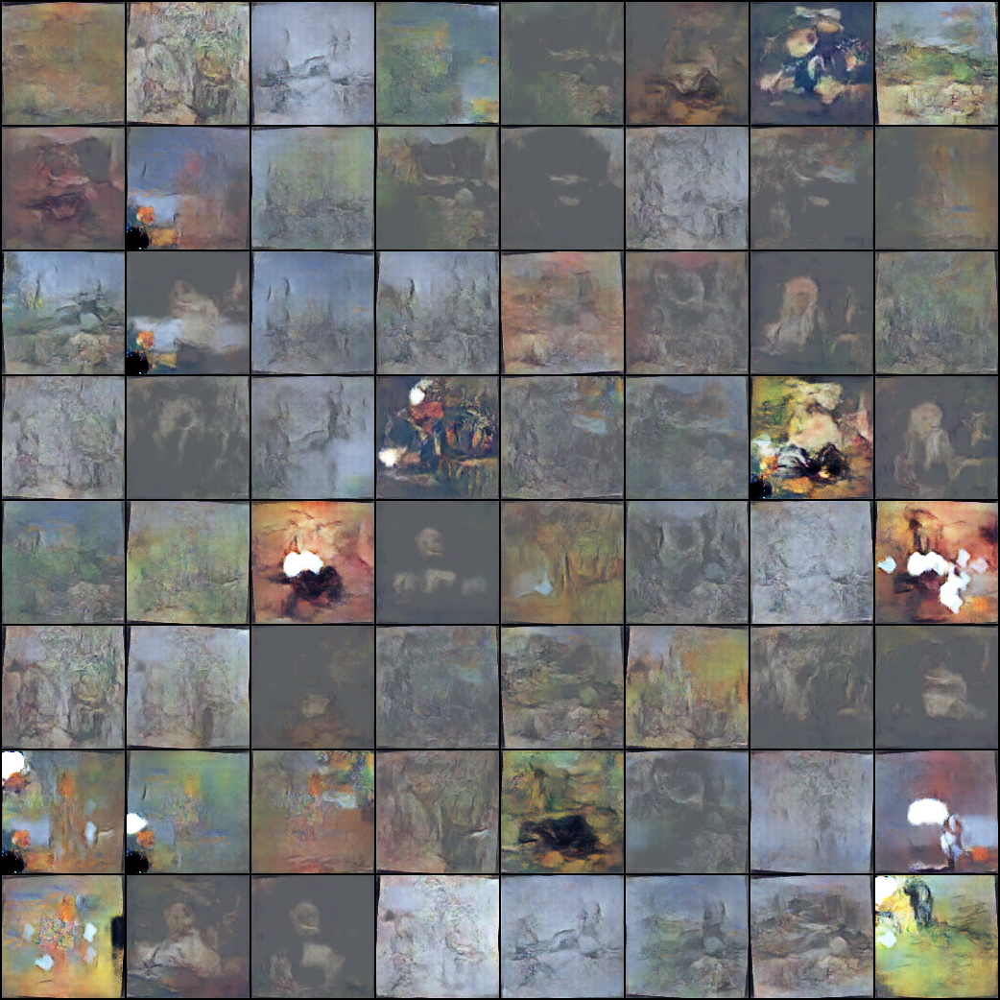

In [23]:
Image('./generated_images/generated_images_epoch_100.png')

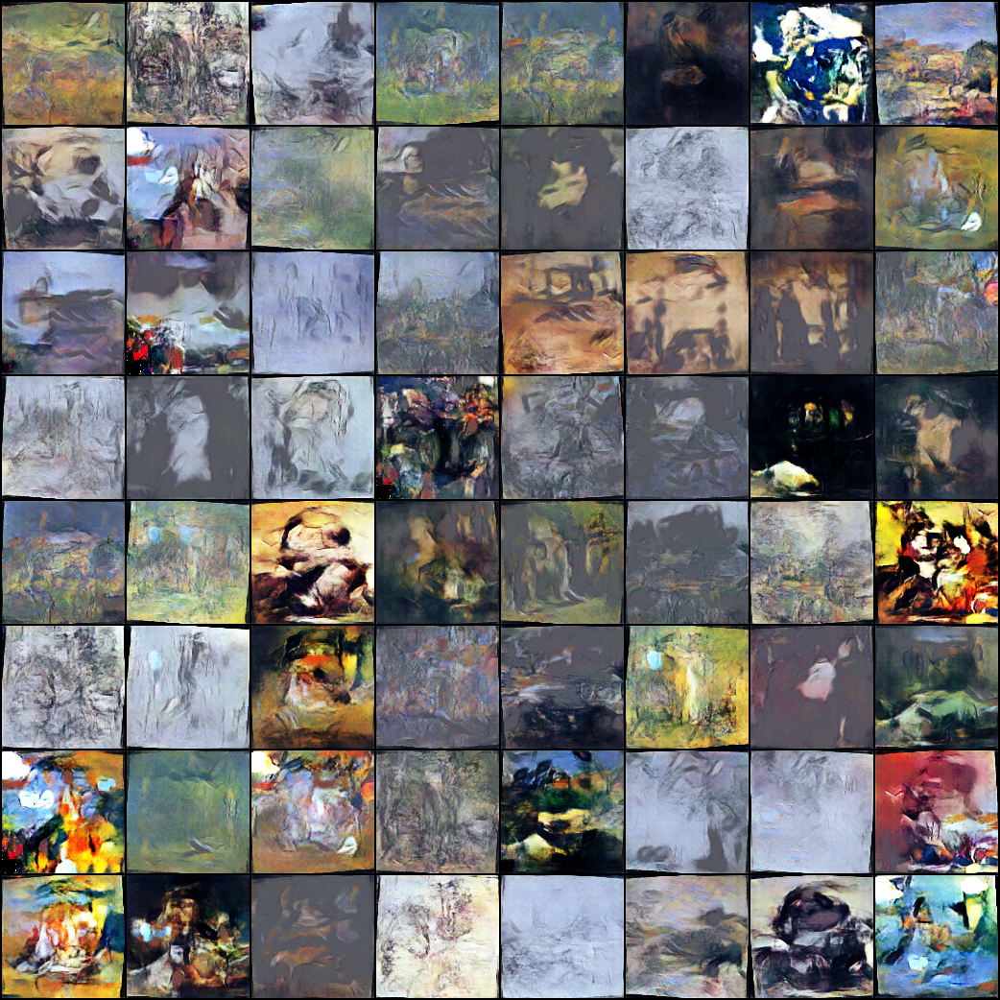

In [24]:
Image('./generated_images/generated_images_epoch_200.png')

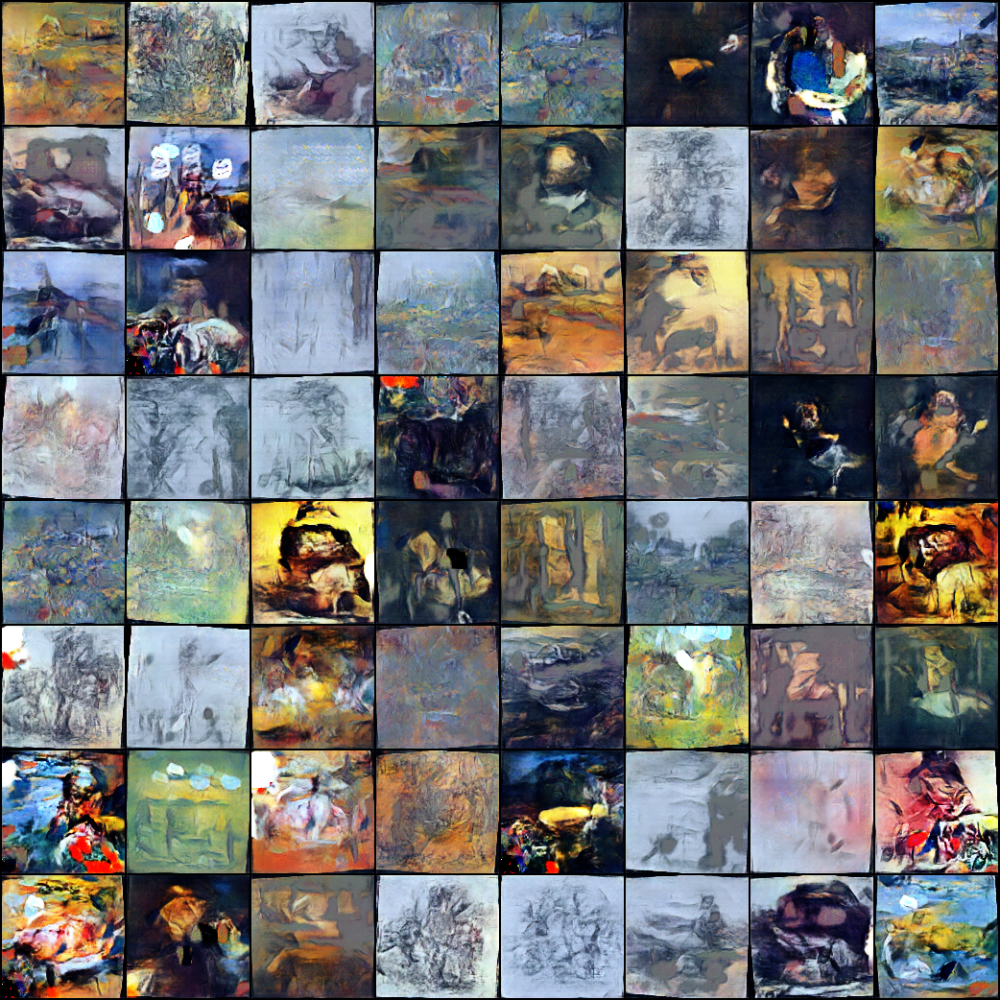

In [25]:
Image('./generated_images/generated_images_epoch_300.png')

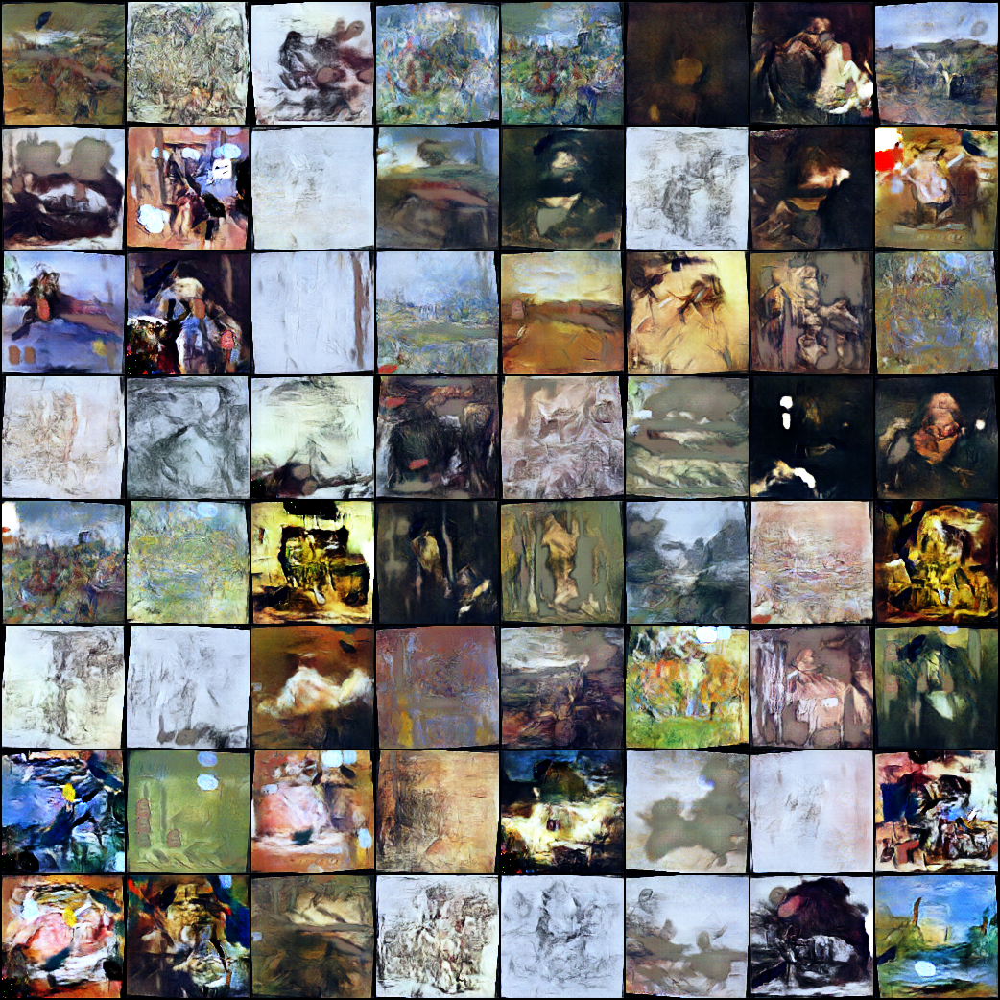

In [26]:
Image('./generated_images/generated_images_epoch_400.png')

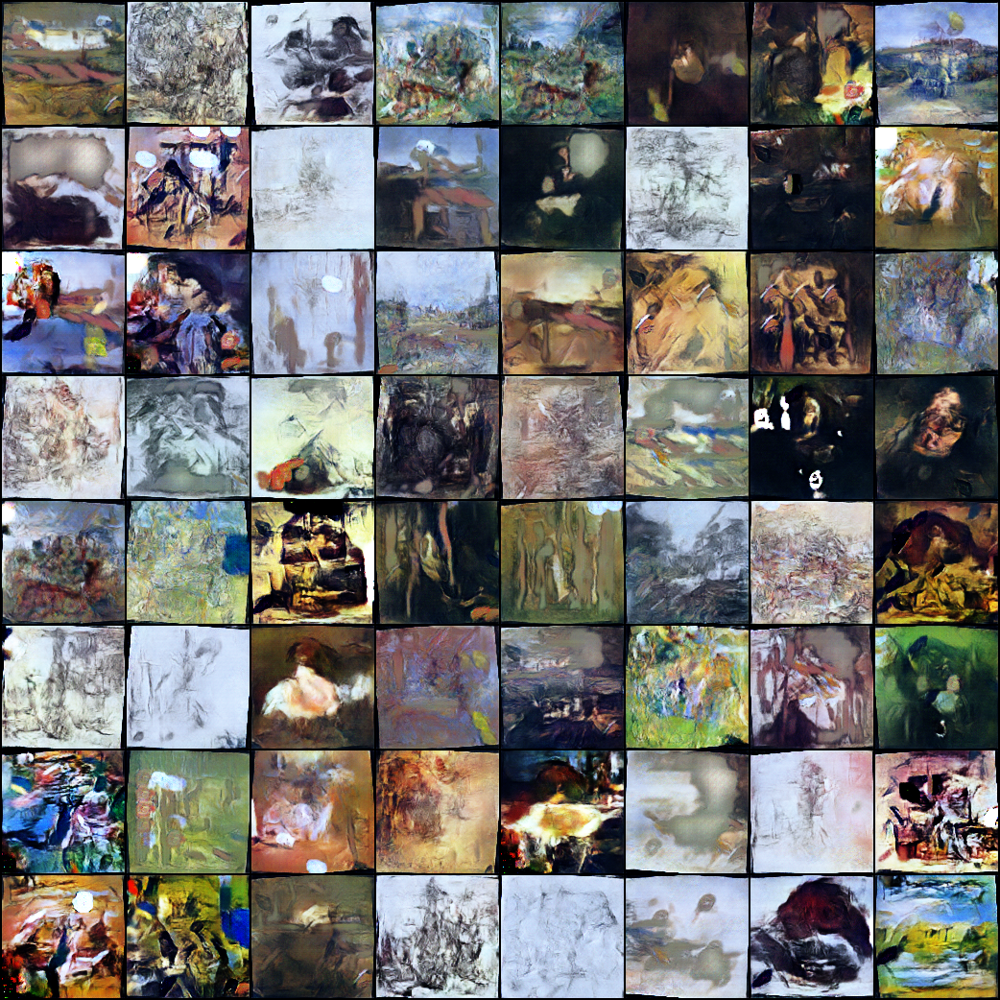

In [27]:
Image('./generated_images/generated_images_epoch_499.png')

In [28]:
# Specify the directory where images are saved
image_folder = '/content/generated_images/'
video_path = '/content/generation_animation.mp4'

# Gather sorted list of images by epoch number
image_files = [f for f in os.listdir(image_folder) if f.startswith('generated_images_epoch_')]
image_files.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))

# Load images and append to the list
images = []
for filename in image_files:
    img_path = os.path.join(image_folder, filename)
    images.append(imageio.imread(img_path))

# Create a video from images
imageio.mimsave(video_path, images, fps=5)  
print(f"Video saved at {video_path}")

<ipython-input-28-75320fa08ed8>:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


Video saved at /content/generation_animation.mp4


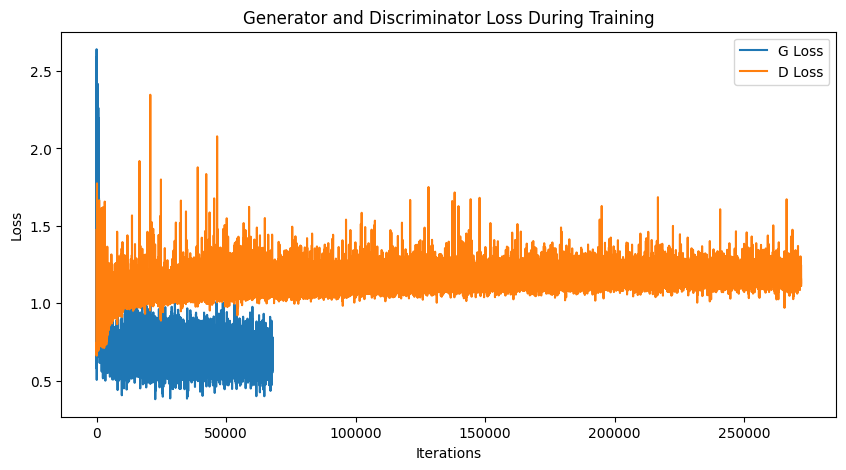

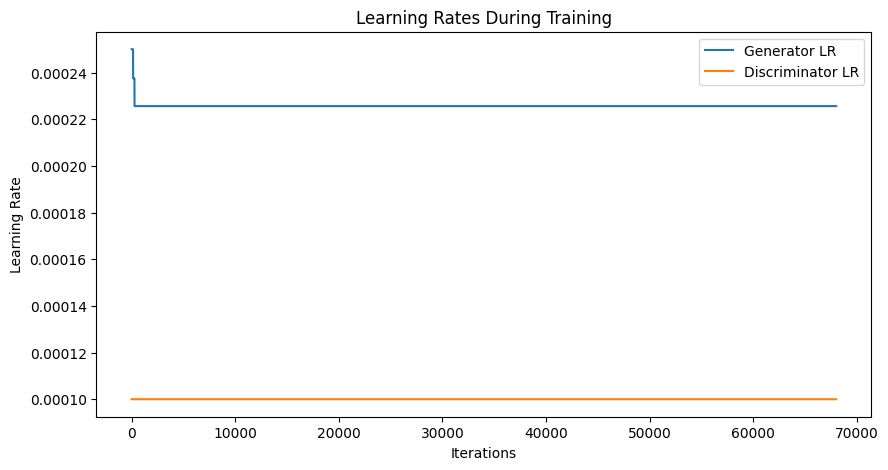

In [29]:
# Plotting Losses
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses, label="G Loss")
plt.plot(discriminator_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Plotting Learning Rates
plt.figure(figsize=(10, 5))
plt.title("Learning Rates During Training")
plt.plot(hyperparams['g_lr'], label="Generator LR")
plt.plot(hyperparams['d_lr'], label="Discriminator LR")
plt.xlabel("Iterations")
plt.ylabel("Learning Rate")
plt.legend()
plt.show()


In [30]:
# Assuming generator and discriminator are already instantiated
print("Generator Summary:")
print(summary(generator, (128, 1, 1)))  # Latent vector size as input

print("Discriminator Summary:")
print(summary(discriminator, (3, 128, 128)))  # Image size as input

Generator Summary:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 1024, 4, 4]       2,097,152
              ReLU-2           [-1, 1024, 4, 4]               0
       BatchNorm2d-3           [-1, 1024, 4, 4]           2,048
   ConvTranspose2d-4            [-1, 512, 8, 8]       8,388,608
              ReLU-5            [-1, 512, 8, 8]               0
       BatchNorm2d-6            [-1, 512, 8, 8]           1,024
   ConvTranspose2d-7          [-1, 256, 16, 16]       2,097,152
              ReLU-8          [-1, 256, 16, 16]               0
       BatchNorm2d-9          [-1, 256, 16, 16]             512
  ConvTranspose2d-10          [-1, 128, 32, 32]         524,288
             ReLU-11          [-1, 128, 32, 32]               0
      BatchNorm2d-12          [-1, 128, 32, 32]             256
  ConvTranspose2d-13           [-1, 64, 64, 64]         131,072
             ReLU-14

In [31]:
# Function to execute shell commands
def shell_cmd(command):
    try:
        return subprocess.check_output(command, shell=True, text=True)
    except subprocess.CalledProcessError:
        return "Unavailable"

# Print CPU Information
print("CPU:", shell_cmd("cat /proc/cpuinfo | grep 'model name' | uniq | awk -F: '{print $2}'"))

# Print GPU Information
gpu_info = shell_cmd("nvidia-smi --query-gpu=gpu_name --format=csv,noheader")
print("GPU:", gpu_info.strip() if gpu_info else "No GPU detected")

# Print System Memory Information
mem_info = shell_cmd("cat /proc/meminfo | grep 'MemTotal' | awk '{print $2/1024 \" MB\"}'")
print("System Memory:", mem_info.strip() if mem_info else "Memory info unavailable")

# Python and PyTorch details
print("Python Version:", sys.version)
print("CUDA Version:", torch.version.cuda if torch.cuda.is_available() else "CUDA not available")
print("Torch Version:", torch.__version__)


CPU:  Intel(R) Xeon(R) CPU @ 2.00GHz

GPU: Tesla V100-SXM2-16GB
System Memory: 52217.5 MB
Python Version: 3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
CUDA Version: 12.1
Torch Version: 2.2.1+cu121
